# __Predicting Burned Calories on Workout__


<p align="center">
  <img src="https://github.com/rymyf/Predict_Calories_Regression/blob/main/pics/rock-art-craft-wellness.jpg?raw=true" alt="Material Bread logo">
</p>


## __Contents:__
> 1. Overview
> 2. Installation
> 3. Read the dataset
> 4. Explore Information
> 5. Cleaning the dataset
>> 1. Handling whitespaces
>> 2. Handling the Missing Values
>> 3. Handling the Outliers
>> 4. Export the cleaned dataset
> 6. Regression Models
>> 1. All Features
>> 2. One Feature



---


## __Overview:__

In this project we take the dataset from kaggle [here](https://www.kaggle.com/emdemor/predicting-burned-calories-on-workout/data)


---

## __Installation:__

In [1]:
# !pip install plotly_express
# !pip install seaborn

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

%matplotlib inline
%config InlineBackend.figure_format = 'svg'

---

## __Read the Dataset:__

In [3]:
# Import Calories Dataset
df_cal = pd.read_csv('data/calories.csv')

# Import Exercises Dataset
df_ex  = pd.read_csv('data/exercise.csv')

# Merging Datasets
df = pd.merge(df_ex, df_cal, on = 'User_ID')
df.head()

,User_ID,Gender,Age,Height,Weight,Duration,Heart_Rate,Body_Temp,Calories
0,14733363,male,68,190.0,94.0,29.0,105.0,40.8,231.0
1,14861698,female,20,166.0,60.0,14.0,94.0,40.3,66.0
2,11179863,male,69,179.0,79.0,5.0,88.0,38.7,26.0
3,16180408,female,34,179.0,71.0,13.0,100.0,40.5,71.0
4,17771927,female,27,154.0,58.0,10.0,81.0,39.8,35.0


---

## __Explore Information:__

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15000 entries, 0 to 14999
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   User_ID     15000 non-null  int64  
 1   Gender      15000 non-null  object 
 2   Age         15000 non-null  int64  
 3   Height      15000 non-null  float64
 4   Weight      15000 non-null  float64
 5   Duration    15000 non-null  float64
 6   Heart_Rate  15000 non-null  float64
 7   Body_Temp   15000 non-null  float64
 8   Calories    15000 non-null  float64
dtypes: float64(6), int64(2), object(1)
memory usage: 1.1+ MB


In [5]:
df.describe()

,User_ID,Age,Height,Weight,Duration,Heart_Rate,Body_Temp,Calories
count,1.500000e+04,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000,15000.000000
mean,1.497736e+07,42.789800,174.465133,74.966867,15.530600,95.518533,40.025453,89.539533
std,2.872851e+06,16.980264,14.258114,15.035657,8.319203,9.583328,0.779230,62.456978
min,1.000116e+07,20.000000,123.000000,36.000000,1.000000,67.000000,37.100000,1.000000
25%,1.247419e+07,28.000000,164.000000,63.000000,8.000000,88.000000,39.600000,35.000000
50%,1.499728e+07,39.000000,175.000000,74.000000,16.000000,96.000000,40.200000,79.000000
75%,1.744928e+07,56.000000,185.000000,87.000000,23.000000,103.000000,40.600000,138.000000
max,1.999965e+07,79.000000,222.000000,132.000000,30.000000,128.000000,41.500000,314.000000


In [6]:
df.size

135000

In [7]:
df.shape

(15000, 9)

In [8]:
df.columns

Index(['User_ID', 'Gender', 'Age', 'Height', 'Weight', 'Duration',
       'Heart_Rate', 'Body_Temp', 'Calories'],
      dtype='object')

In [9]:
df.dtypes

User_ID         int64
Gender         object
Age             int64
Height        float64
Weight        float64
Duration      float64
Heart_Rate    float64
Body_Temp     float64
Calories      float64
dtype: object

In [10]:
df.Gender.value_counts()

female    7553
male      7447
Name: Gender, dtype: int64

In [11]:
df.Age.nunique()

60

In [12]:
df.Age.unique()

array([68, 20, 69, 34, 27, 36, 33, 41, 60, 26, 21, 66, 32, 53, 39, 46, 50,
       67, 31, 48, 29, 42, 62, 38, 25, 24, 22, 74, 70, 44, 61, 63, 54, 47,
       35, 28, 77, 64, 45, 57, 49, 40, 55, 23, 43, 52, 79, 51, 59, 30, 37,
       56, 58, 78, 73, 76, 72, 65, 71, 75])

In [13]:
df.Age.value_counts()

20    512
21    497
22    489
26    452
25    435
24    426
23    411
27    396
28    390
29    379
32    370
31    339
35    327
30    325
33    320
38    311
34    285
37    283
36    279
39    276
40    260
44    259
42    257
41    252
43    250
46    233
45    233
52    225
47    223
50    220
48    219
54    217
49    208
55    204
53    201
59    198
51    197
56    190
63    182
58    182
61    181
62    180
57    177
64    176
60    172
65    169
73    167
71    163
67    162
70    154
68    150
66    147
79    147
69    145
74    142
76    139
72    137
78    133
77    130
75    117
Name: Age, dtype: int64

In [14]:
df.sample(60)

,User_ID,Gender,Age,Height,Weight,Duration,Heart_Rate,Body_Temp,Calories
2036,15801734,male,33,188.0,83.0,17.0,93.0,40.5,72.0
2806,12685054,male,72,194.0,97.0,27.0,107.0,40.9,230.0
10167,17714621,male,57,181.0,89.0,16.0,95.0,40.5,93.0
13146,11917088,male,25,177.0,80.0,7.0,88.0,39.8,21.0
14128,14364777,female,26,157.0,56.0,15.0,96.0,40.3,76.0
1049,13053708,male,31,198.0,99.0,28.0,107.0,40.9,185.0
9346,15486821,male,35,189.0,91.0,22.0,104.0,40.5,136.0
9046,12651082,male,27,181.0,79.0,2.0,79.0,38.2,4.0
12106,10655273,male,32,176.0,82.0,9.0,86.0,39.5,28.0
811,18986390,female,24,167.0,68.0,18.0,93.0,40.6,82.0


---

## __Cleaning the Dataset:__

### Handling whitespaces:

In [15]:
# strip whitespaces in columns
df.columns.str.strip()

Index(['User_ID', 'Gender', 'Age', 'Height', 'Weight', 'Duration',
       'Heart_Rate', 'Body_Temp', 'Calories'],
      dtype='object')

In [16]:
# strip whitespaces in values of multiple columns
df['Gender'] = df['Gender'].apply(lambda x: x.strip())

### Handling the Missing Values:

In [17]:
# Check for null values
df.isna().sum()

User_ID       0
Gender        0
Age           0
Height        0
Weight        0
Duration      0
Heart_Rate    0
Body_Temp     0
Calories      0
dtype: int64

In [18]:
# Find Outliers

### Standaraized Floats

In [19]:
pd.set_option('display.float_format' ,lambda x:'%.2f' % x)

### Export the cleaned dataset:

In [20]:
df.to_csv("cleaned_exer_cal_dataset.csv")

## __Regression models:__

### All Features:

#### Pre-Processing:

##### Import Laibraries:

In [21]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error,r2_score
from sklearn.preprocessing import StandardScaler


##### Root Mean Square Error Function:

In [22]:
# root mean squared error
def RMSE(actuals, preds): 
    return np.sqrt(np.mean((actuals - preds)**2))


##### Dummies Variable:

In [23]:
# Gender
df.Gender = pd.get_dummies(df.Gender, drop_first=True) #can just apply it to the whole df

In [24]:
df

,User_ID,Gender,Age,Height,Weight,Duration,Heart_Rate,Body_Temp,Calories
0,14733363,1,68,190.00,94.00,29.00,105.00,40.80,231.00
1,14861698,0,20,166.00,60.00,14.00,94.00,40.30,66.00
2,11179863,1,69,179.00,79.00,5.00,88.00,38.70,26.00
3,16180408,0,34,179.00,71.00,13.00,100.00,40.50,71.00
4,17771927,0,27,154.00,58.00,10.00,81.00,39.80,35.00
...,...,...,...,...,...,...,...,...,...
14995,15644082,0,20,193.00,86.00,11.00,92.00,40.40,45.00
14996,17212577,0,27,165.00,65.00,6.00,85.00,39.20,23.00
14997,17271188,0,43,159.00,58.00,16.00,90.00,40.10,75.00
14998,18643037,1,78,193.00,97.00,2.00,84.00,38.30,11.00


##### Feature Selection:

In [25]:
corr_cal = pd.DataFrame( df.corr()['Calories'] )

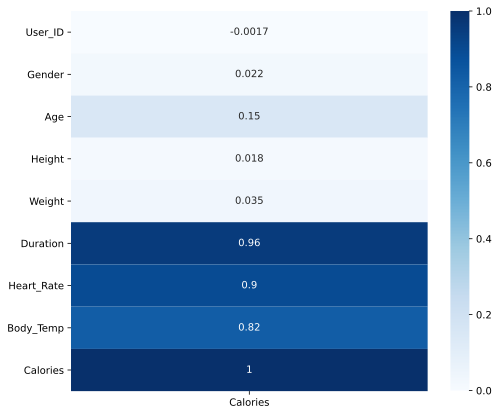

In [26]:
plt.figure(figsize=(8,7))
sns.heatmap(corr_cal,annot=True,cmap="Blues");

In [27]:
sns.pairplot(df[['Body_Temp', 'Heart_Rate', 'Duration','Calories']]);

In [28]:
# Input features
X = df.loc[:,['Body_Temp', 'Heart_Rate', 'Duration']]

# Output target
y = df['Calories']

In [29]:
X

,Body_Temp,Heart_Rate,Duration
0,40.80,105.00,29.00
1,40.30,94.00,14.00
2,38.70,88.00,5.00
3,40.50,100.00,13.00
4,39.80,81.00,10.00
...,...,...,...
14995,40.40,92.00,11.00
14996,39.20,85.00,6.00
14997,40.10,90.00,16.00
14998,38.30,84.00,2.00


In [30]:
y

0       231.00
1        66.00
2        26.00
3        71.00
4        35.00
         ...  
14995    45.00
14996    23.00
14997    75.00
14998    11.00
14999    98.00
Name: Calories, Length: 15000, dtype: float64

##### Split Data:

In [31]:
#Split the data 60 - 20 - 20 train/val/test
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2,random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=.25, random_state=43)

##### Scaling Data:

In [32]:
#Feature scaling for train, val, and test so that we can run our ridge model on each
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train.values)
X_val_scaled = scaler.transform(X_val.values)
X_test_scaled = scaler.transform(X_test.values)

#### Models:

##### Linear Regression:

In [33]:
# Create linear regression
lm = LinearRegression()

# Fit a model by using 60% Train data
lm.fit(X_train, y_train)

# extract feature coefficients and intercept from fit model
print(lm.intercept_)
print(lm.coef_)

# Calculate R^2
print(f'Linear Regression val R^2: {lm.score(X_val, y_val):.3f}')

# Prediction
lm_preds = lm.predict(X_val)
lm_preds

# Calculate root mean square error
RMSE(y_val,lm_preds)

469.566265220588
[-16.7972307    1.98113898   6.61947743]
Linear Regression val R^2: 0.945


14.868834957176377

##### Polynomial Regression:

In [34]:
#Feature transforms for train, val, and test so that we can run our poly model on each
poly = PolynomialFeatures(degree=4) 

X_train_poly = poly.fit_transform(X_train.values)
X_val_poly = poly.transform(X_val.values)
X_test_poly = poly.transform(X_test.values)

# Create linear polynomial regression
lm_poly = LinearRegression()

# Fit a model by using 60% Train data
lm_poly.fit(X_train_poly, y_train)

# extract feature coefficients and intercept from fit model
print(lm_poly.intercept_)
print(lm_poly.coef_)

# Calculate R^2
print(f'Degree 4 polynomial regression val R^2: {lm_poly.score(X_val_poly, y_val):.3f}')

# Prediction
lm_poly_preds = lm_poly.predict(X_val_poly)
lm_poly_preds

# Calculate root mean square error
RMSE(y_val,lm_poly_preds)

-4544349.694504711
[-1.38405489e-01  4.02131446e+05  3.09554503e+04 -7.93360387e+04
 -1.32065263e+04 -2.14817703e+03  5.29230083e+03 -6.30494916e+01
  3.64534439e+02 -3.46741946e+02  1.89530924e+02  5.06942306e+01
 -1.17360506e+02  2.40634044e+00 -1.61319710e+01  1.48210066e+01
  1.41428801e-01 -6.42725413e-01  1.26675545e+00 -5.28563677e-01
 -9.90179768e-01 -4.12355431e-01  8.67149569e-01 -1.81752168e-02
  1.74585899e-01 -1.55754518e-01 -4.25430780e-03  1.59590746e-02
 -2.87161151e-02  1.06207840e-02  7.04808668e-05  1.20021814e-04
 -9.20753965e-04  1.21139696e-03 -2.35644216e-04]
Degree 4 polynomial regression val R^2: 0.961


12.508591080406866

##### Decision Tree Regression:

In [35]:
# Create Decision Tree Model
tree_model= DecisionTreeRegressor()

# Fit a model by using 60% Train data
tree_model.fit(X_train,y_train)

# Calculate R^2
print(f'Decision tree val R^2:{tree_model.score(X_val,y_val):.3f}')

# Prediction
tree_preds = tree_model.predict(X_val)
tree_preds

# Calculate root mean square error
RMSE(y_val,tree_preds)

Decision tree val R^2:0.942


15.308184819328758

##### Random Forest Regression:

In [36]:
# Create random forest regression
rand_model = RandomForestRegressor(n_estimators = 10, random_state = 0)

# Fit a model by using 60% Train data
rand_model.fit(X_train, y_train)

# Calculate R^2
print(f'Random Forest val R^2:{rand_model.score(X_val,y_val):.3f}')

# Prediction
random_preds = rand_model.predict(X_val)
random_preds

# Calculate root mean square error
RMSE(y_val,random_preds)


Random Forest val R^2:0.949


14.340202082405757

#### Comparison:

##### R^2 and RMSE:

In [37]:
# Calculate the R^2 and RMSE
lm_r2_v = lm.score(X_val, y_val)
lmpoly_r2_v = lm_poly.score(X_val_poly, y_val)
tree_r2_v = tree_model.score(X_val,y_val)
random_r2_v = rand_model.score(X_val,y_val)

print(f'Linear Regression val R^2: {lm_r2_v:.3f}\nLinear Regression Root Mean Square Error : {RMSE(y_val,lm_preds):.3f}\n')
print(f'Degree 4 polynomial regression val R^2: {lmpoly_r2_v:.3f}\nDegree 4 Polynomial Regression Root Mean Square Error : {RMSE(y_val,lm_poly_preds):.3f}\n')
print(f'Decision tree val R^2:{tree_r2_v:.3f}\nDecision Tree Regression Root Mean Square Error : {RMSE(y_val,tree_preds):.3f}\n')
print(f'Random Forest val R^2:{random_r2_v:.3f}\nRandom Forest Regression Root Mean Square Error : {RMSE(y_val,random_preds):.3f}\n')

# Calculate the R^2 and RMSE
lm_r2_t = lm.score(X_train, y_train)
lmpoly_r2_t = lm_poly.score(X_train_poly, y_train)
tree_r2_t = tree_model.score(X_train,y_train)
random_r2_t = rand_model.score(X_train,y_train)

print(f'Linear Regression train R^2: {lm_r2_t:.3f}\nLinear Regression Root Mean Square Error : {RMSE(y_train,lm.predict(X_train)):.3f}\n')
print(f'Degree 4 polynomial regression train R^2: {lmpoly_r2_t:.3f}\nDegree 4 Polynomial Regression Root Mean Square Error : {RMSE(y_train,lm_poly.predict(X_train_poly)):.3f}\n')
print(f'Decision tree train R^2:{ tree_r2_t:.3f}\nDecision Tree Regression Root Mean Square Error : {RMSE(y_train,tree_model.predict(X_train)):.3f}\n')
print(f'Random Forest train R^2:{random_r2_t:.3f}\nRandom Forest Regression Root Mean Square Error : {RMSE(y_train,rand_model.predict(X_train)):.3f}')



Linear Regression val R^2: 0.945
Linear Regression Root Mean Square Error : 14.869

Degree 4 polynomial regression val R^2: 0.961
Degree 4 Polynomial Regression Root Mean Square Error : 12.509

Decision tree val R^2:0.942
Decision Tree Regression Root Mean Square Error : 15.308

Random Forest val R^2:0.949
Random Forest Regression Root Mean Square Error : 14.340

Linear Regression train R^2: 0.947
Linear Regression Root Mean Square Error : 14.275

Degree 4 polynomial regression train R^2: 0.962
Degree 4 Polynomial Regression Root Mean Square Error : 11.979

Decision tree train R^2:0.980
Decision Tree Regression Root Mean Square Error : 8.831

Random Forest train R^2:0.977
Random Forest Regression Root Mean Square Error : 9.418


In [38]:
f3_comparison = {"model": ["Linear Regression","Degree 4 Polynomial Regression", "Decision Tree Regression", "Random Forest Regression"],
            "train%60_r2": [lm_r2_t, lmpoly_r2_t, tree_r2_t, random_r2_t],
             "validation%20_r2": [lm_r2_v, lmpoly_r2_v, tree_r2_v, random_r2_v],
             "RMSE_train%60": [RMSE(y_train,lm.predict(X_train)), RMSE(y_train,lm_poly.predict(X_train_poly)), RMSE(y_train,tree_model.predict(X_train)), RMSE(y_train,rand_model.predict(X_train))],
              "RMSE_validation%20": [RMSE(y_val,lm_preds), RMSE(y_val,lm_poly_preds), RMSE(y_val,tree_preds), RMSE(y_val,random_preds)]  }

f3_comparison = pd.DataFrame(f3_comparison) 
f3_comparison.set_index('model',inplace=True)
f3_comparison

,train%60_r2,validation%20_r2,RMSE_train%60,RMSE_validation%20
model,,,,
Linear Regression,0.95,0.95,14.27,14.87
Degree 4 Polynomial Regression,0.96,0.96,11.98,12.51
Decision Tree Regression,0.98,0.94,8.83,15.31
Random Forest Regression,0.98,0.95,9.42,14.34


##### Test the data:

In [39]:
# Fit the model on 80% and Test 20% 

#Feature transforms for train, val, and test so that we can run our poly model on each
poly = PolynomialFeatures(degree=4) 

X_train_val_poly = poly.fit_transform(X_train_val.values)
X_val_poly = poly.transform(X_val.values)
X_test_poly = poly.transform(X_test.values)

# Create linear polynomial regression
lm_poly = LinearRegression()

# Fit a model by using 80% Train data
lm_poly.fit(X_train_val_poly, y_train_val)

# extract feature coefficients and intercept from fit model
print(lm_poly.intercept_)
print(lm_poly.coef_)

# Calculate R^2
# train
lm_poly_r2_train = lm_poly.score(X_train_val_poly, y_train_val)
# test
lm_poly_r2_test = lm_poly.score(X_test_poly, y_test)
print(f'Degree 4 polynomial regression test R^2: {lm_poly_r2_test:.3f}')
# Prediction
lm_poly_preds = lm_poly.predict(X_test_poly)
lm_poly_preds

# Calculate root mean square error
# train
RMSE_train = RMSE(y_train_val,lm_poly.predict(X_train_val_poly))
# test
RMSE_test= RMSE(y_test,lm_poly_preds)

-5773878.010819944
[-2.27402379e-01  5.53342552e+05  2.07347582e+04 -8.61201139e+04
 -1.99567249e+04 -1.40261699e+03  6.07557064e+03 -5.12342284e+01
  2.55054374e+02 -3.46681368e+02  3.20529317e+02  3.23558686e+01
 -1.43697345e+02  1.93096140e+00 -1.09419816e+01  1.54711105e+01
  1.20363292e-01 -5.43437215e-01  1.00425247e+00 -5.43171222e-01
 -1.92877682e+00 -2.60007884e-01  1.14240149e+00 -1.37426295e-02
  1.12644069e-01 -1.71529011e-01 -3.72296922e-03  1.38101354e-02
 -2.26754934e-02  1.12012397e-02  7.19707101e-05  6.11062182e-05
 -7.94253714e-04  1.14051090e-03 -2.80791139e-04]
Degree 4 polynomial regression test R^2: 0.962


In [40]:
test_model_f3 = pd.DataFrame({"model":["Degree 4 polynomial Regression"], "train%80_r2":[lm_poly_r2_train], "test%20_r2":[lm_poly_r2_test], "RMSE_train%80": [RMSE_train], "RMSE_test%20": [RMSE_test]})
test_model_f3.set_index('model',inplace=True)
test_model_f3

,train%80_r2,test%20_r2,RMSE_train%80,RMSE_test%20
model,,,,
Degree 4 polynomial Regression,0.96,0.96,12.11,12.39


### One Feature:

#### Pre-Processing:

##### Feature Selection:

In [41]:
corr_cal = pd.DataFrame( df.corr()['Calories'] )

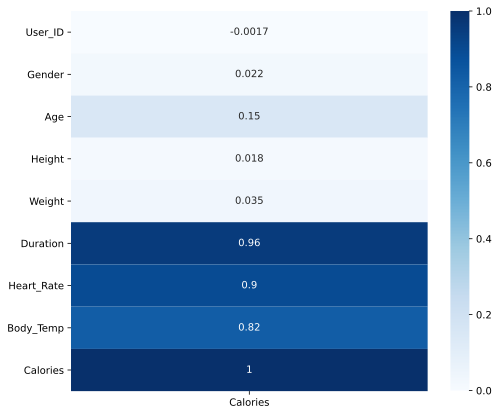

In [42]:
plt.figure(figsize=(8,7))
sns.heatmap(corr_cal,annot=True,cmap="Blues");

In [43]:
# Input features
X = df['Duration'].to_numpy()

# Output target
y = df['Calories'].to_numpy()

In [44]:
X

array([29., 14.,  5., ..., 16.,  2., 18.])

In [45]:
y

array([231.,  66.,  26., ...,  75.,  11.,  98.])

##### Split Data:

In [46]:
#Split the data 60 - 20 - 20 train/val/test
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2,random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X_train_val, y_train_val, test_size=.25, random_state=43)

##### Scaling Data:

In [47]:
#Feature scaling for train, val, and test so that we can run our ridge model on each
scaler = StandardScaler()

X_train_scaled = scaler.fit_transform(X_train.reshape(-1,1))
X_val_scaled = scaler.transform(X_val.reshape(-1,1))
X_test_scaled = scaler.transform(X_test.reshape(-1,1))

#### Models:

##### Linear Regression:

In [48]:
# Create linear regression
lm = LinearRegression()

# Fit a model by using 60% Train data
lm.fit(X_train.reshape(-1,1), y_train.reshape(-1,1))

# extract feature coefficients and intercept from fit model
print(lm.intercept_)
print(lm.coef_)

# Calculate R^2
print(f'Linear Regression val R^2: {lm.score(X_val.reshape(-1,1), y_val.reshape(-1,1)):.3f}')

# Prediction
lm_preds = lm.predict(X_val.reshape(-1,1))
lm_preds

# Calculate root mean square error
RMSE(y_val.reshape(-1,1),lm_preds)

[-21.79441746]
[[7.14792435]]
Linear Regression val R^2: 0.911


18.94369491358099

##### Polynomial Regression:

In [49]:
#Feature transforms for train, val, and test so that we can run our poly model on each
poly = PolynomialFeatures(degree=4) 

X_train_poly = poly.fit_transform(X_train.reshape(-1,1))
X_val_poly = poly.transform(X_val.reshape(-1,1))
X_test_poly = poly.transform(X_test.reshape(-1,1))

# Create linear polynomial regression
lm_poly = LinearRegression()

# Fit a model by using 60% Train data
lm_poly.fit(X_train_poly, y_train.reshape(-1,1))

# extract feature coefficients and intercept from fit model
print(lm_poly.intercept_)
print(lm_poly.coef_)

# Calculate R^2
print(f'Degree 4 polynomial regression val R^2: {lm_poly.score(X_val_poly, y_val.reshape(-1,1)):.3f}')

# Prediction
lm_poly_preds = lm_poly.predict(X_val_poly)
lm_poly_preds

# Calculate root mean square error
RMSE(y_val.reshape(-1,1),lm_poly_preds)

[-1.37314071]
[[ 0.00000000e+00  4.02513432e+00  6.60116166e-03  6.44580462e-03
  -1.12337453e-04]]
Degree 4 polynomial regression val R^2: 0.927


17.185247389575757

##### Decision Tree Regression:

In [50]:
# Create Decision Tree Model
tree_model= DecisionTreeRegressor()

# Fit a model by using 60% Train data
tree_model.fit(X_train.reshape(-1,1),y_train.reshape(-1,1))

# Calculate R^2
print(f'Decision tree val R^2:{tree_model.score(X_val.reshape(-1,1),y_val.reshape(-1,1)):.3f}')

# Prediction
tree_preds = tree_model.predict(X_val.reshape(-1,1))
tree_preds

# Calculate root mean square error
RMSE(y_val,tree_preds)

Decision tree val R^2:0.926


17.236582258304814

##### Random Forest Regression:

In [51]:
# Create random forest regression
rand_model = RandomForestRegressor(n_estimators = 10, random_state = 0)

# Fit a model by using 60% Train data
rand_model.fit(X_train.reshape(-1,1), y_train.reshape(-1,1))

# Calculate R^2
print(f'Random Forest val R^2:{rand_model.score(X_val.reshape(-1,1),y_val.reshape(-1,1)):.3f}')

# Prediction
random_preds = rand_model.predict(X_val.reshape(-1,1))
random_preds

# Calculate root mean square error
RMSE(y_val,random_preds)


Random Forest val R^2:0.926


<ipython-input-51-03d45de1e8f5>:5: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  rand_model.fit(X_train.reshape(-1,1), y_train.reshape(-1,1))


17.24522633225074

#### Comparison:

##### R^2 and RMSE:

In [52]:
# Calculate the R^2 and RMSE
lm_r2_v = (lm.score(X_val.reshape(-1,1), y_val.reshape(-1,1)))
lmpoly_r2_v = lm_poly.score(X_val_poly, y_val.reshape(-1,1))
tree_r2_v = tree_model.score(X_val.reshape(-1,1),y_val.reshape(-1,1))
random_r2_v = rand_model.score(X_val.reshape(-1,1),y_val.reshape(-1,1))

print(f'Linear Regression val R^2: {lm_r2_v:.3f}\nLinear Regression Root Mean Square Error : {RMSE(y_val.reshape(-1,1),lm_preds):.3f}\n')
print(f'Degree 4 polynomial regression val R^2: {lmpoly_r2_v:.3f}\nDegree 4 Polynomial Regression Root Mean Square Error : {RMSE(y_val.reshape(-1,1),lm_poly_preds):.3f}\n')
print(f'Decision tree val R^2:{tree_r2_v:.3f}\nDecision Tree Regression Root Mean Square Error : {RMSE(y_val,tree_preds):.3f}\n')
print(f'Random Forest val R^2:{random_r2_v:.3f}\nRandom Forest Regression Root Mean Square Error : {RMSE(y_val,random_preds):.3f}\n')

# Calculate the R^2 and RMSE
lm_r2_t = lm.score(X_train.reshape(-1,1), y_train.reshape(-1,1))
lmpoly_r2_t = lm_poly.score(X_train_poly, y_train.reshape(-1,1))
tree_r2_t = tree_model.score(X_train.reshape(-1,1),y_train.reshape(-1,1))
random_r2_t = rand_model.score(X_train.reshape(-1,1),y_train.reshape(-1,1))

print(f'Linear Regression train R^2: {lm_r2_t:.3f}\nLinear Regression Root Mean Square Error : {RMSE(y_train.reshape(-1,1),lm.predict(X_train.reshape(-1,1))):.3f}\n')
print(f'Degree 4 polynomial regression train R^2: {lmpoly_r2_t:.3f}\nDegree 4 Polynomial Regression Root Mean Square Error : {RMSE(y_train.reshape(-1,1),lm_poly.predict(X_train_poly)):.3f}\n')
print(f'Decision tree train R^2:{ tree_r2_t:.3f}\nDecision Tree Regression Root Mean Square Error : {RMSE(y_train,tree_model.predict(X_train.reshape(-1,1))):.3f}\n')
print(f'Random Forest train R^2:{random_r2_t:.3f}\nRandom Forest Regression Root Mean Square Error : {RMSE(y_train,rand_model.predict(X_train.reshape(-1,1))):.3f}')



Linear Regression val R^2: 0.911
Linear Regression Root Mean Square Error : 18.944

Degree 4 polynomial regression val R^2: 0.927
Degree 4 Polynomial Regression Root Mean Square Error : 17.185

Decision tree val R^2:0.926
Decision Tree Regression Root Mean Square Error : 17.237

Random Forest val R^2:0.926
Random Forest Regression Root Mean Square Error : 17.245

Linear Regression train R^2: 0.913
Linear Regression Root Mean Square Error : 18.226

Degree 4 polynomial regression train R^2: 0.929
Degree 4 Polynomial Regression Root Mean Square Error : 16.503

Decision tree train R^2:0.929
Decision Tree Regression Root Mean Square Error : 16.477

Random Forest train R^2:0.929
Random Forest Regression Root Mean Square Error : 16.479


In [53]:
f1_comparison = {"model": ["Linear Regression","Degree 4 Polynomial Regression", "Decision Tree Regression", "Random Forest Regression"],
            "train%60_r2": [lm_r2_t, lmpoly_r2_t, tree_r2_t, random_r2_t],
             "validation%20_r2": [lm_r2_v, lmpoly_r2_v, tree_r2_v, random_r2_v],
             "RMSE_train%60": [RMSE(y_train.reshape(-1,1),lm.predict(X_train.reshape(-1,1))), RMSE(y_train.reshape(-1,1),lm_poly.predict(X_train_poly)), RMSE(y_train,tree_model.predict(X_train.reshape(-1,1))), RMSE(y_train,rand_model.predict(X_train.reshape(-1,1)))],
              "RMSE_validation%20": [RMSE(y_val.reshape(-1,1),lm_preds), RMSE(y_val.reshape(-1,1),lm_poly_preds), RMSE(y_val,tree_preds), RMSE(y_val,random_preds)]  }

f1_comparison = pd.DataFrame(f1_comparison) 
f1_comparison.set_index('model', inplace=True)
f1_comparison 

,train%60_r2,validation%20_r2,RMSE_train%60,RMSE_validation%20
model,,,,
Linear Regression,0.91,0.91,18.23,18.94
Degree 4 Polynomial Regression,0.93,0.93,16.50,17.19
Decision Tree Regression,0.93,0.93,16.48,17.24
Random Forest Regression,0.93,0.93,16.48,17.25


##### Visualization:

In [54]:
# Plotting and comparing

X_grid = np.arange(min(X_val),max(X_val),0.1)
X_grid = X_grid.reshape(len(X_grid),1) 
 
 
plt.figure(figsize=(10, 8))
plt.scatter(df['Duration'],df['Calories'],c='lightgray',label = 'observations',alpha = 0.6,marker='.',zorder=1);
plt.plot(X_grid,lm.predict(X_grid), c='tab:green',ls='-', label = 'Linear model', lw = 3,zorder=2);
plt.plot(X_grid, lm_poly.predict(poly.fit_transform(X_grid)), c='tab:blue',ls='--', label = 'Polynomial model', lw = 3,zorder=2);
plt.plot(X_grid,tree_model.predict(X_grid), c='tab:red',ls='-.', label = 'Decision Tree model', lw = 3,zorder=2);
plt.plot(X_grid,rand_model.predict(X_grid), label = 'Random Forest Model', c='tab:orange',zorder=2);

plt.xlabel('Duration (min)', size = 18);
plt.ylabel('Calories', size = 18);
plt.legend(prop={'size': 16});
plt.title('Calories burned vs Duration of Exercise', size = 20);

##### Test the data:

In [55]:
# Fit the model on 80% and Test 20% 

#Feature transforms for train, val, and test so that we can run our poly model on each
poly = PolynomialFeatures(degree=4) 

X_train_val_poly = poly.fit_transform(X_train_val.reshape(-1,1))
X_val_poly = poly.transform(X_val.reshape(-1,1))
X_test_poly = poly.transform(X_test.reshape(-1,1))

# Create linear polynomial regression
lm_poly = LinearRegression()

# Fit a model by using 80% Train data
lm_poly.fit(X_train_val_poly, y_train_val)

# extract feature coefficients and intercept from fit model
print(lm_poly.intercept_)
print(lm_poly.coef_)

# Calculate R^2
# train
lm_poly_r2_train = lm_poly.score(X_train_val_poly, y_train_val)
# test
lm_poly_r2_test = lm_poly.score(X_test_poly, y_test)
print(f'Degree 4 polynomial regression test R^2: {lm_poly_r2_test:.3f}')

# Prediction
lm_poly_preds = lm_poly.predict(X_test_poly)
lm_poly_preds

# Calculate root mean square error
# train
RMSE_train = RMSE(y_train_val,lm_poly.predict(X_train_val_poly))
# test
RMSE_test= RMSE(y_test,lm_poly_preds)

-0.8756077282588848
[ 0.00000000e+00  3.76626254e+00  4.63797011e-02  4.29907738e-03
 -7.49212655e-05]
Degree 4 polynomial regression test R^2: 0.932


In [56]:
test_model_f1 = pd.DataFrame({"model":["Degree 4 polynomial Regression"], "train%80_r2":[lm_poly_r2_train], "test%20_r2":[lm_poly_r2_test], "RMSE_train%80": [RMSE_train], "RMSE_test%20": [RMSE_test]})
test_model_f1.set_index('model',inplace=True)
test_model_f1

,train%80_r2,test%20_r2,RMSE_train%80,RMSE_test%20
model,,,,
Degree 4 polynomial Regression,0.93,0.93,16.67,16.58
